Import needed libraries:

In [ ]:
import moviepy.editor as mpe
# from IPython.display import display
from glob import glob

In [ ]:
import sys, os
import numpy as np
import scipy

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt

In [ ]:
# MAX_ITERS = 10
TOL = 1.0e-8

In [ ]:
video = mpe.VideoFileClip("/content/video.mp4")

In [ ]:
import moviepy.editor as mpe

def display_video(video_path):
    # Load the video.
    video = mpe.VideoFileClip(video_path)

    # Play the video.
    video.preview()

if __name__ == "__main__":
    # The path to the video file.
    video_path = "/content/video.mp4"

    # Display the video.
    display_video(video_path)

In [ ]:
import cv2

def display_video(video_path):
    # Load the video.
    video = cv2.VideoCapture(video_path)

    # Check if the video is opened successfully.
    if not video.isOpened():
        print("Could not open video")
        return

    # Read the first frame of the video.
    ret, frame = video.read()

    # Check if the frame was read successfully.
    if not ret:
        print("Could not read frame")
        return

    # Display the frame.
    cv2.imshow("Video", frame)

    # Wait for the user to press a key.
    cv2.waitKey(0)

    # Close the video.
    video.release()

if __name__ == "__main__":
    # The path to the video file.

    video_path = "path/to/video.mp4"

    # Display the video.
    display_video(video_path)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


chunk:  19%|█▉        | 47/243 [00:00<00:00, 269.58it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/audio/io/readers.py:197: UserWarning: Error in file /content/video.mp4, At time t=2.26-2.31 seconds, indices wanted: 90130-92126, but len(buffer)=90317
index 90317 is out of bounds for axis 0 with size 90317
  warnings.warn("Error in file %s, "%(self.filename)+

index 90317 is out of bounds for axis 0 with size 90317
  warnings.warn("Error in file %s, "%(self.filename)+

index 90317 is out of bounds for axis 0 with size 90317
  warnings.warn("Error in file %s, "%(self.filename)+

index 90317 is out of bounds for axis 0 with size 90317
  warnings.warn("Error in file %s, "%(self.filename)+

index 90317 is out of bounds for axis 0 with size 90317
  warnings.warn("Error in file %s, "%(self.filename)+

index 90317 is out of bounds for axis 0 with size 90317
  warnings.warn("Error in file %s, "%(self.filename)+

index 90317 is out of bounds for axis 0 with siz

MoviePy - Done.
Moviepy - Writing video __temp__.mp4



t:  26%|██▌       | 69/264 [00:12<00:25,  7.52it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file /content/video.mp4, 24883200 bytes wanted but 0 bytes read,at frame 68/307, at time 2.84/12.78 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

t:  27%|██▋       | 70/264 [00:13<00:25,  7.54it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file /content/video.mp4, 24883200 bytes wanted but 0 bytes read,at frame 69/307, at time 2.88/12.78 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

t:  27%|██▋       | 72/264 [00:13<00:21,  8.79it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: W

Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [ ]:
video.duration

12.78

### Helper Methods

In [ ]:
from PIL import Image

def create_data_matrix_from_video(clip, k=10, scale = (160,120)):   #k = 5 scale = (160, 120)
  return np.vstack([np.array(Image.fromarray(rgb2gray(clip.get_frame(i/float(k))).astype(np.uint8)).resize(scale)).flatten() for i in range(k * int(clip.duration))]).T

In [ ]:
def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.299, 0.587, 0.114])

In [ ]:
def plt_images(M, A, E, index_array, dims, filename=None):
    f = plt.figure(figsize=(15, 10))
    r = len(index_array)
    pics = r * 3
    for k, i in enumerate(index_array):
        for j, mat in enumerate([M, A, E]):
            sp = f.add_subplot(r, 3, 3*k + j + 1)
            sp.axis('Off')
            pixels = mat[:,i]
            if isinstance(pixels, scipy.sparse.csr_matrix):
                pixels = pixels.todense()
            plt.imshow(np.reshape(pixels, dims), cmap='gray')
    return f

In [ ]:
def plots(ims, dims, figsize=(15,20), rows=1, interp=False, titles=None):
    if type(ims[0]) is np.ndarray:
        ims = np.array(ims)
    f = plt.figure(figsize=figsize)
    for i in range(len(ims)):
        sp = f.add_subplot(rows, (len(ims)+rows-1)//rows, i+1)
        sp.axis('Off')
        plt.imshow(np.reshape(ims[i], dims), cmap="gray")


### Load and view the data

An image from 1 moment in time is 60 pixels by 80 pixels (when scaled). We can *unroll* that picture into a single tall column. So instead of having a 2D picture that is $60 \times 80$, we have a $1 \times 4,800$ column

This isn't very human-readable, but it's handy because it lets us stack the images from different times on top of one another, to put a video all into 1 matrix.  If we took the video image every tenth of a second for 113 seconds (so 11,300 different images, each from a different point in time), we'd have a $11300 \times 4800$ matrix, representing the video!

In [ ]:
scale = 25   # Adjust scale to change resolution of image
dims = (int(240 * (scale/100)), int(320 * (scale/100)))

In [13]:
M = create_data_matrix_from_video(video,100, (80,60))

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.warn("Warning: in file %s, "%(self.filename)+

  warnings.war

In [14]:
print(dims, M.shape)

(60, 80) (4800, 1200)


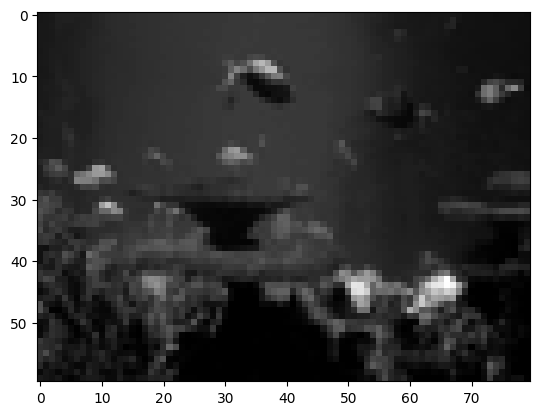

In [15]:
plt.imshow(np.reshape(M[:,140], dims), cmap='gray');

Since `create_data_from_matrix` is somewhat slow, we will save our matrix.  In general, whenever you have slow pre-processing steps, it's a good idea to save the results for future use.

In [16]:
np.save("low_res_matrix.npy", M)

Note: High-res M is too big to plot, so only run the below with the low-res version

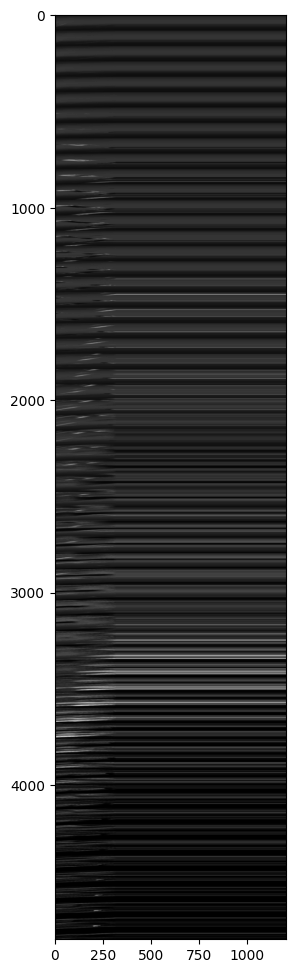

In [17]:
plt.figure(figsize=(12, 12))
plt.imshow(M, cmap='gray')

**Questions**: What are those wavy black lines?  What are the horizontal lines?

In [18]:
plt.imsave(fname="image.jpg", arr=np.reshape(M[:,140], dims), cmap='gray')

## SVD

### A first attempt with SVD

In [19]:
from sklearn import decomposition

In [20]:
u, s, v = decomposition.randomized_svd(M, 2)

In [21]:
u.shape, s.shape, v.shape

((4800, 2), (2,), (2, 1200))

In [22]:
low_rank = u @ np.diag(s) @ v

In [23]:
low_rank.shape

(4800, 1200)

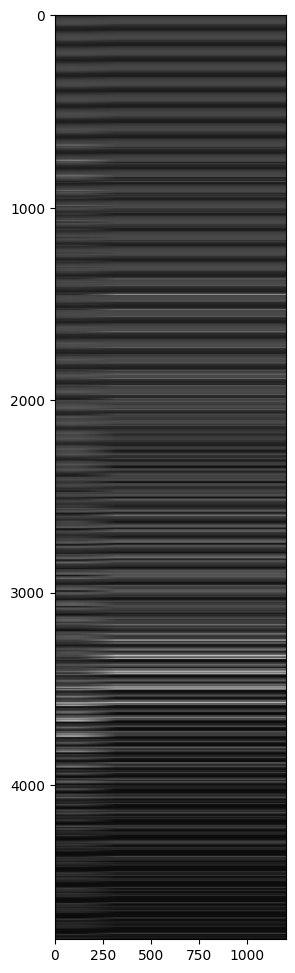

In [24]:
plt.figure(figsize=(12, 12))
plt.imshow(low_rank, cmap='gray')

The below images were created with high-res data.  Very slow to process:

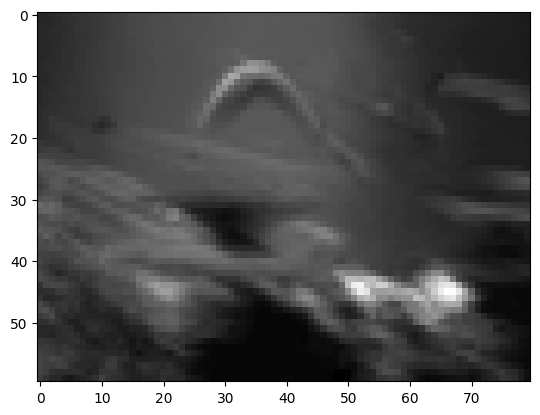

In [25]:
plt.imshow(np.reshape(low_rank[:,140], dims), cmap='gray');

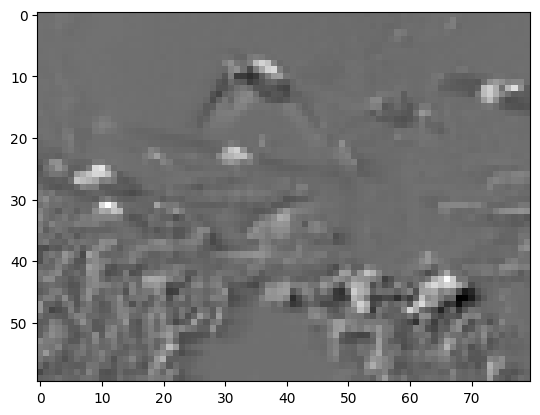

In [26]:
plt.imshow(np.reshape(M[:,140] - low_rank[:,140], dims), cmap='gray');

#### Rank 1 Approximation

In [27]:
u, s, v = decomposition.randomized_svd(M, 1)

In [28]:
u.shape, s.shape, v.shape

((4800, 1), (1,), (1, 1200))

In [29]:
low_rank = u @ np.diag(s) @ v

In [30]:
low_rank.shape

(4800, 1200)

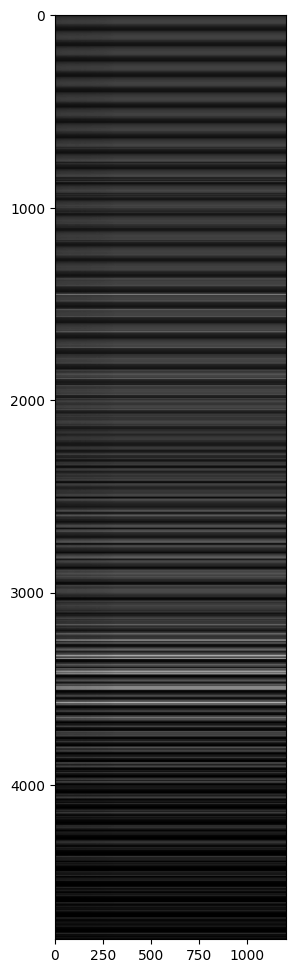

In [31]:
plt.figure(figsize=(12, 12))
plt.imshow(low_rank, cmap='gray')

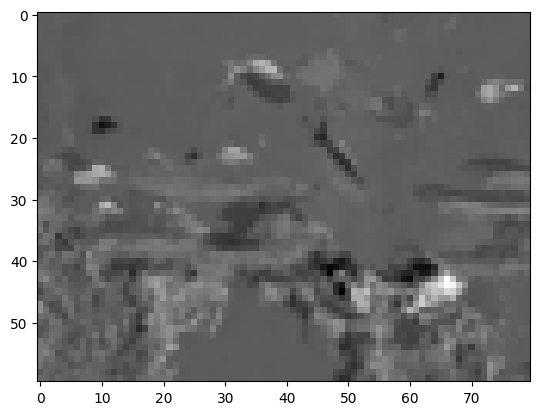

In [32]:
plt.imshow(np.reshape(M[:,140] - low_rank[:,140], dims), cmap='gray');

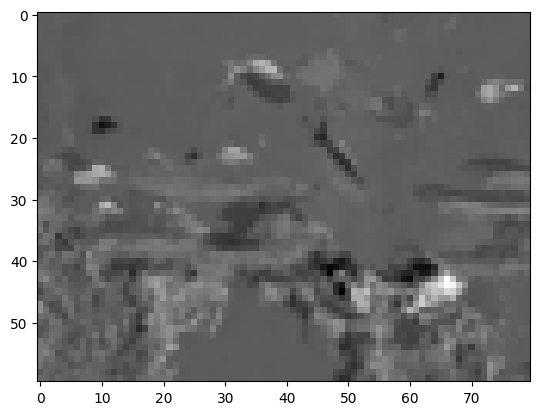

In [34]:
plt.imshow(np.reshape(M[:,140] - low_rank[:,140], dims), cmap='gray');

Let's zoom in on the people:

## Principal Component Analysis (PCA)

When dealing with high-dimensional data sets, we often leverage on the fact that the data has **low intrinsic dimensionality** in order to alleviate the curse of dimensionality and scale (perhaps it lies in a low-dimensional subspace or lies on a low-dimensional manifold). [Principal component analysis](http://setosa.io/ev/principal-component-analysis/) is handy for eliminating dimensions.  Classical PCA seeks the best rank-$k$ estimate $L$ of $M$ (minimizing $\| M - L \|$ where $L$ has rank-$k$).  Truncated SVD makes this calculation!

Traditional PCA can handle small noise, but is brittle with respect to grossly corrupted observations-- even one grossly corrupt observation can significantly mess up answer.

**Robust PCA** factors a matrix into the sum of two matrices, $M = L + S$, where $M$ is the original matrix, $L$ is **low-rank**, and $S$ is **sparse**.  This is what we'll be using for the background removal problem! **Low-rank** means that the matrix has a lot of redundant information-- in this case, it's the background, which is the same in every scene (talk about redundant info!).  **Sparse** means that the matrix has mostly zero entries-- in this case, see how the picture of the foreground (the people) is mostly empty.  (In the case of corrupted data, $S$ is capturing the corrupted entries).

### Applications of Robust PCA
- **Video Surveillance**

- **Face Recognition** photos from this excellent [tutorial](https://jeankossaifi.github.io/tensorly/rpca.html).  The dataset here consists of images of the faces of several people taken from the same angle but with different illumniations.

  <img src="images/faces_rpca.png" alt="Robust PCA" style="width: 80%"/>
  ([Source: Jean Kossaifi](https://jeankossaifi.github.io/tensorly/rpca.html))

  <img src="images/faces_rpca_gross.png" alt="Robust PCA" style="width: 80%"/>
  ([Source: Jean Kossaifi](https://jeankossaifi.github.io/tensorly/rpca.html))

- Latent Semantic Indexing: $L$ captures common words used in all documents while $S$ captures the few key words that best distinguish each document from others

- Ranking and Collaborative Filtering: a small portion of the available rankings could be noisy and even tampered with (see [Netflix RAD - Outlier Detection on Big Data](http://techblog.netflix.com/2015/02/rad-outlier-detection-on-big-data.html) on the official netflix blog)

## Robust PCA (via Primary Component Pursuit)

### Methods

We will use [Facebook's Fast Randomized PCA](https://github.com/facebook/fbpca) library.

In [35]:
!pip install fbpca

  Preparing metadata (setup.py) ... done
  Created wheel for fbpca: filename=fbpca-1.0-py3-none-any.whl size=11373 sha256=74b452f894c49d764af166329eed0a8446feb2997e928953b969cddcc824a62a
  Stored in directory: /root/.cache/pip/wheels/3c/ea/60/8d1c9fbbc99492a1775b36a5e29c8c1ef309cc5821bd5a219d
Successfully built fbpca


In [36]:
from scipy import sparse
from sklearn.utils.extmath import randomized_svd
import fbpca

In [37]:
TOL=1e-10
MAX_ITERS=20

In [38]:
def converged(Z, d_norm):
    err = np.linalg.norm(Z, 'fro') / d_norm
    print('error: ', err)
    return err < TOL

In [39]:
def shrink(M, tau):
    S = np.abs(M) - tau
    return np.sign(M) * np.where(S>0, S, 0)

In [40]:
def _svd(M, rank): return fbpca.pca(M, k=min(rank, np.min(M.shape)), raw=True)

In [41]:
def norm_op(M): return _svd(M, 1)[1][0]

In [42]:
def svd_reconstruct(M, rank, min_sv):
    u, s, v = _svd(M, rank)
    s -= min_sv
    nnz = (s > 0).sum()
    return u[:,:nnz] @ np.diag(s[:nnz]) @ v[:nnz], nnz

In [43]:
def pcp(X, maxiter=20, k=10): # refactored
    m, n = X.shape
    trans = m<n
    if trans: X = X.T; m, n = X.shape

    lamda = 1/np.sqrt(m)
    op_norm = norm_op(X)
    Y = np.copy(X) / max(op_norm, np.linalg.norm( X, np.inf) / lamda)
    mu = k*1.5/op_norm; mu_bar = mu * 1e8; rho = k * 1.5

    d_norm = np.linalg.norm(X, 'fro')
    L = np.zeros_like(X); sv = 1

    examples = []

    for i in range(maxiter):
        print("rank sv:", sv)
        X2 = X + Y/mu

        # update estimate of Sparse Matrix by "shrinking/truncating": original - low-rank
        S = shrink(X2 - L, lamda/mu)

        # update estimate of Low-rank Matrix by doing truncated SVD of rank sv & reconstructing.
        # count of singular values > 1/mu is returned as svp
        L, svp = svd_reconstruct(X2 - S, sv, 1/mu)
        #svp - sum of sparse values
        # If svp < sv, you are already calculating enough singular values.
        # If not, add 20% (in this case 240) to sv
        sv = svp + (1 if svp < sv else round(0.05*n))

        # residual
        Z = X - L - S
        Y += mu*Z; mu *= rho

        examples.extend([S[140,:], L[140,:]])

        if m > mu_bar: m = mu_bar
        if converged(Z, d_norm): break

    if trans: L=L.T; S=S.T
    return L, S, examples

### Results

In [44]:
m, n = M.shape
round(m * .05)

240

In [45]:
L, S, examples =  pcp(M, maxiter=20, k=10)

rank sv: 1
error:  0.2303668819692796
rank sv: 61
error:  0.018000388849039005
rank sv: 14
error:  0.0018300628015288536
rank sv: 74
error:  8.563364091833568e-05
rank sv: 56
error:  1.9811501307482095e-06
rank sv: 116
error:  7.30016369382021e-08
rank sv: 69
error:  1.4552909780906021e-09
rank sv: 69
error:  7.454456286166339e-11


ValueError: ignored

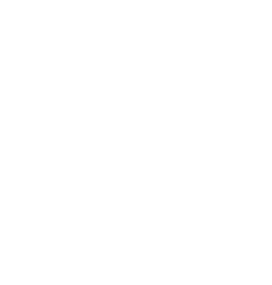

In [46]:
plots(examples, dims, rows=5)

In [ ]:
f = plt_images(M, S, L, [140], dims)

In [ ]:
np.save("high_res_L2.npy", L)
np.save("high_res_S2.npy", S)

In [ ]:
f = plt_images(M, S, L, [0, 140, 1000], dims)

Extracting a bit of the foreground is easier than identifying the background.  To accurately get the background, you need to remove all the foreground, not just parts of it